# COMPLEX NETWORKS: FINAL PROJECT

Lorenzo Sala, mat. 943481

Warning: the execution of the code may be very slow on Colab and the RAM of the free tier might not be enough. I strongly recommend running it on a local jupyter server.

### setup and packages

In [1]:
!pip install pycairo
!pip install igraph
!pip install rustworkx
!pip install powerlaw

In [1]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import collections as cl
import igraph as ig
import rustworkx as rx
import powerlaw as pw

In [ ]:
df = pd.read_csv("deezer_europe_edges.csv")  #replace with your actual file path

#create an undirected graph (use `nx.DiGraph()` if it's directed)
G = nx.from_pandas_edgelist(df, source='node_1', target='node_2')

In [4]:
G.number_of_nodes(),G.number_of_edges()

(28281, 92752)

In [5]:
#Rustworkx version of Networkx graph:
G_rx = rx.networkx_converter(G)

### Distances

In [6]:
avg_path_length = rx.graph_unweighted_average_shortest_path_length(G_rx)
print(f"Average path length: {avg_path_length}")

Average path length: 6.449804500370024


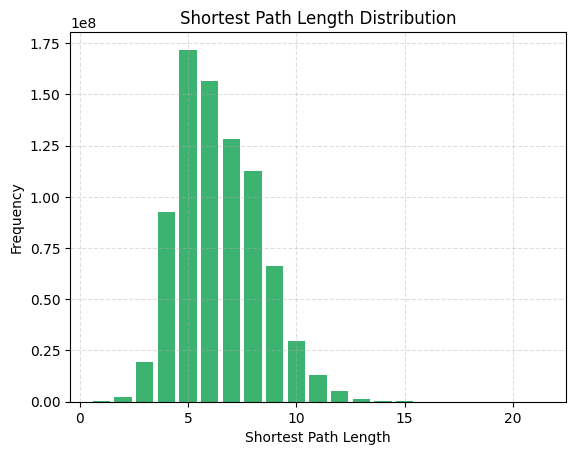

In [7]:
#!! possibly long execution! ~40s on my laptop

#calculate distances: we use rx's function 
dist = rx.distance_matrix(G_rx)

flat = dist.ravel() #flatten the array
#remove 0, NaNs and other "bad" things
filtered = flat[(flat > 0) & np.isfinite(flat)]

values, counts = np.unique(filtered, return_counts=True)

plt.bar(values, counts, color='mediumseagreen')
plt.xlabel("Shortest Path Length")
plt.ylabel("Frequency")
plt.title("Shortest Path Length Distribution")
plt.grid(True, linestyle='--', alpha=0.4)
plt.show()


In [8]:
diameter = np.max(dist[np.isfinite(dist)])
print(f"Graph diameter: {diameter:.0f}")

Graph diameter: 21


### Degree analysis

In [9]:
#simply use numpy's functions on the list of degrees
degrees = [deg for _, deg in G.degree()]
avg_deg = np.mean(degrees)
std_deg = np.std(degrees)
var_deg = np.var(degrees)

print(f"Average degree: {avg_deg:.4f}")
print(f"Standard deviation: {std_deg:.4f}")
print(f"Variance: {var_deg:.4f}")

Average degree: 6.5593
Standard deviation: 7.9460
Variance: 63.1389


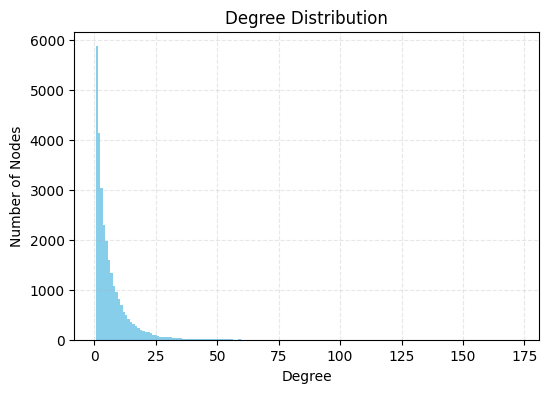

In [10]:
#plot a histogram of the degree distribution:

deg_counts = cl.Counter(degrees)
x = sorted(deg_counts)
y = [deg_counts[k] for k in x]

plt.figure(figsize=(6, 4))
plt.bar(x, y, width=1, color='skyblue')
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")
plt.title("Degree Distribution")
plt.grid(True, linestyle='--', alpha=0.3)
plt.show()

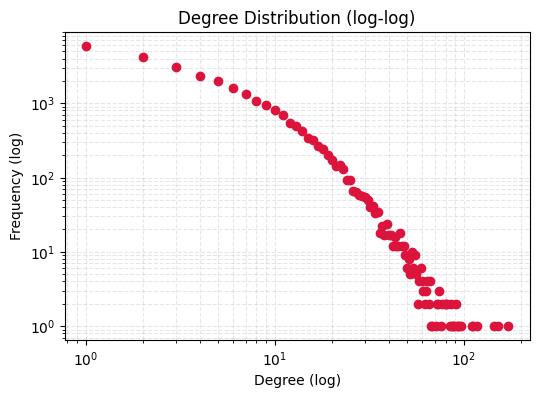

In [11]:
#plot a log-log scatterplot with the same data

plt.figure(figsize=(6, 4))
plt.loglog(x, y, marker='o', linestyle='none', color='crimson')
plt.xlabel("Degree (log)")
plt.ylabel("Frequency (log)")
plt.title("Degree Distribution (log-log)")
plt.grid(True, which="both", linestyle='--', alpha=0.3)
plt.show()

In [12]:
#use powerlaw's fitting function
fit = pw.Fit(degrees, discrete=True)
print(f"Estimated power-law exponent (alpha): {fit.power_law.alpha:.4f}")
print(f"Minimum degree for power-law (xmin): {fit.power_law.xmin}")

#compare vs exponential
R, p = fit.distribution_compare('power_law', 'exponential')
print(f"Power law vs exponential: R = {R:.4f}, p = {p:.4f}")

Calculating best minimal value for power law fit
Estimated power-law exponent (alpha): 4.8567
Minimum degree for power-law (xmin): 45.0
Power law vs exponential: R = 4.1996, p = 0.2346


In [13]:
#clustering per node
clustering = nx.clustering(G)  #returns a dictionary with the node as key and the clustering coefficient as value

#average clustering coefficient
avg_clustering = nx.average_clustering(G)
print(f"Average clustering coefficient: {avg_clustering:.4f}")

#global transitivity
transitivity = nx.transitivity(G)
print(f"Global transitivity: {transitivity:.4f}")

Average clustering coefficient: 0.1412
Global transitivity: 0.0959


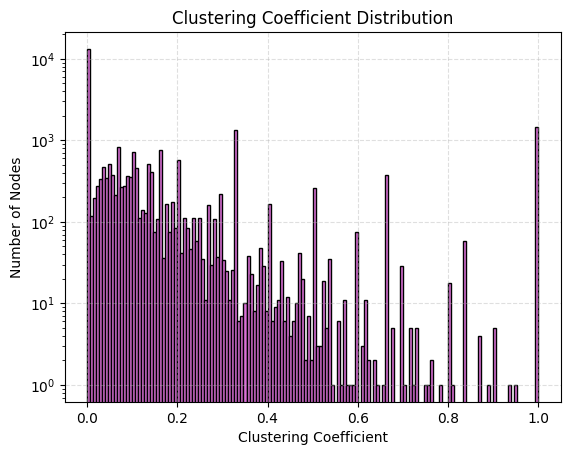

In [14]:

plt.hist(clustering.values(), bins=150, color='orchid', edgecolor='k')
plt.yscale('log')
plt.xlabel("Clustering Coefficient")
plt.ylabel("Number of Nodes")
plt.title("Clustering Coefficient Distribution")
plt.grid(True, linestyle='--', alpha=0.4)
plt.show()

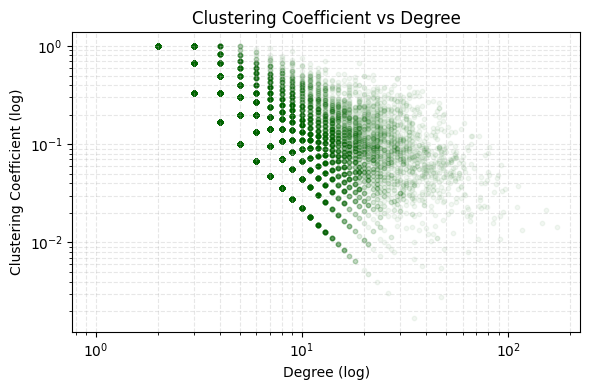

In [15]:
#get degrees and clustering coefficients
degree_dict = dict(G.degree())
clustering_dict = nx.clustering(G)

#build arrays for plotting
degrees = np.array(list(degree_dict.values()))
clustering = np.array(list(clustering_dict.values()))

#plot
plt.figure(figsize=(6, 4))
plt.scatter(degrees, clustering, alpha=0.05, s=10, color='darkgreen')
plt.xscale('log')
plt.yscale('log')
plt.xlabel("Degree (log)")
plt.ylabel("Clustering Coefficient (log)")
plt.title("Clustering Coefficient vs Degree")
plt.grid(True, which='both', linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()

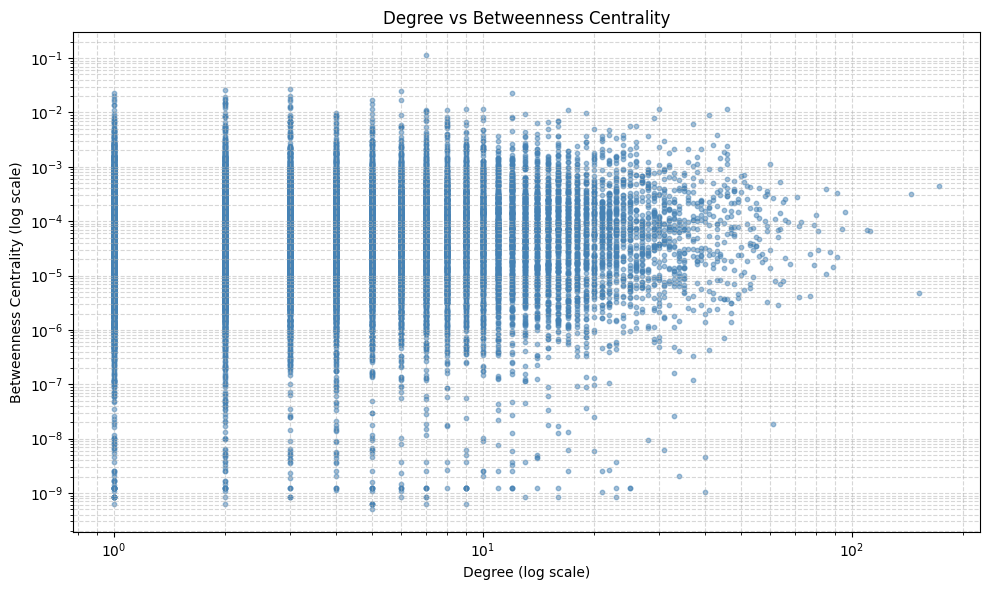

In [16]:
#!! possibly long execution (1m 40s on my laptop)

#get betweenness
betweenness_dict = rx.betweenness_centrality(G_rx)

#extract values
degrees = []
betweennesses = []

for node in G.nodes():
    degrees.append(degree_dict[node])
    betweennesses.append(betweenness_dict[node])

#plot them
plt.figure(figsize=(10, 6))
plt.scatter(degrees, betweennesses, alpha=0.5, s=10, color='steelblue')
plt.xscale('log')
plt.yscale('log')
plt.xlabel("Degree (log scale)")
plt.ylabel("Betweenness Centrality (log scale)")
plt.title("Degree vs Betweenness Centrality")
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

### Largest component analysis

In [17]:
#get all connected components (as sets of nodes)
components = nx.connected_components(G)

#get the largest one (by number of nodes)
largest_cc = max(components, key=len)
lcc_size = len(largest_cc)

print(f"Largest connected component size: {lcc_size}")

Largest connected component size: 28281


### Degree correlation

In [18]:
#compute assortativity
assortativity = nx.degree_assortativity_coefficient(G)
print(f"Degree assortativity coefficient: {assortativity:.4f}")

Degree assortativity coefficient: 0.1041


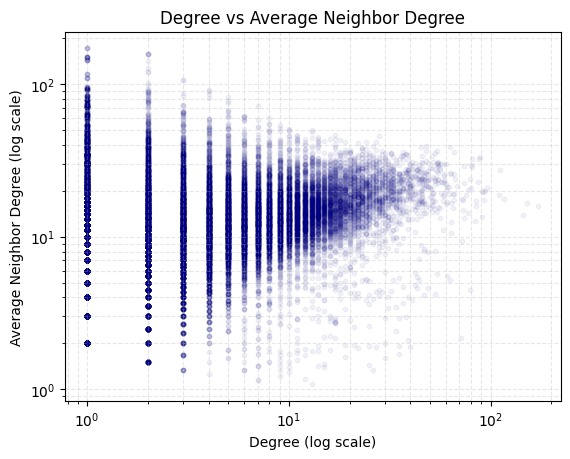

In [19]:
avg_neighbor_deg = nx.average_neighbor_degree(G)
degrees = dict(G.degree())

x = np.array([degrees[n] for n in G.nodes()])
y = np.array([avg_neighbor_deg[n] for n in G.nodes()])

plt.scatter(x, y, alpha=0.05, s=10, color='navy')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree (log scale)')
plt.ylabel('Average Neighbor Degree (log scale)')
plt.title('Degree vs Average Neighbor Degree')
plt.grid(True, which='both', linestyle='--', alpha=0.3)
plt.show()

### Community detection

In [20]:
G_ig = ig.Graph.TupleList(G.edges(), directed=False)
partition = G_ig.community_multilevel()  #louvain
print(f"Found {len(partition)} communities")

layout = G_ig.layout("fr")
colors = [part % 20 for part in partition.membership]  # modulo for repeating color palette

ig.plot(
    partition,
    mark_groups=True,
    layout=layout,
    vertex_size=3,
    vertex_color=colors,
    edge_width=0.2,
    bbox=(500, 500),
    margin=20
)

Found 78 communities


Number of communities: 78
Modularity of the partition: 0.6827
Min size: 4
Max size: 4200
Mean size: 362.58
Median size: 31.50
Std dev: 783.59


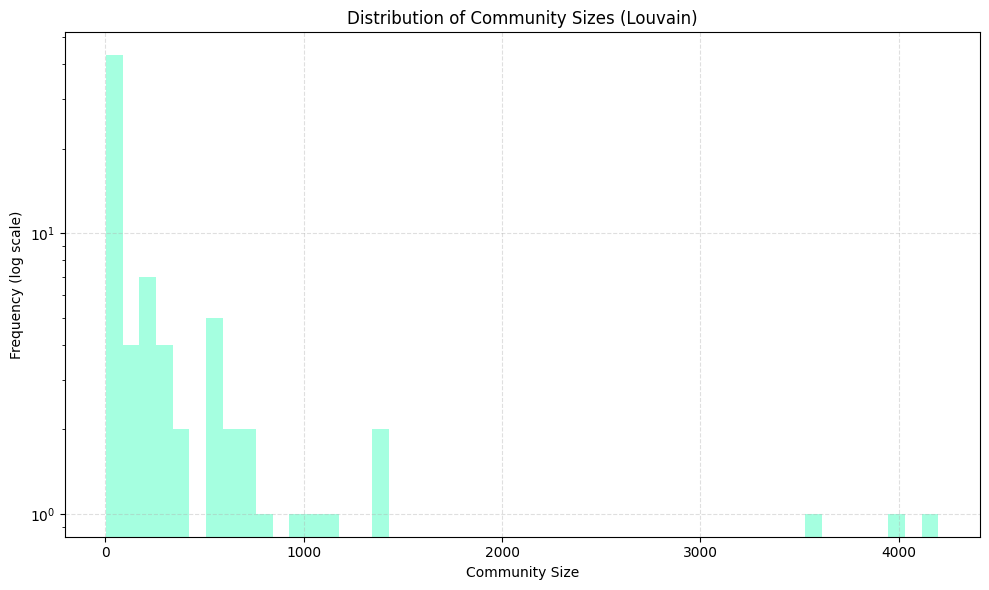

In [21]:
community_sizes = [len(c) for c in partition]

#print some basic information
sizes = np.array(community_sizes)
print(f"Number of communities: {len(sizes)}")
print(f"Modularity of the partition: {partition.modularity:.4f}")
print(f"Min size: {sizes.min()}")
print(f"Max size: {sizes.max()}")
print(f"Mean size: {sizes.mean():.2f}")
print(f"Median size: {np.median(sizes):.2f}")
print(f"Std dev: {sizes.std():.2f}")

#plot a histogram
plt.figure(figsize=(10,6))
plt.hist(sizes, bins=50, color="aquamarine", alpha=0.7)
plt.yscale('log')
plt.xlabel("Community Size")
plt.ylabel("Frequency (log scale)")
plt.title("Distribution of Community Sizes (Louvain)")
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()

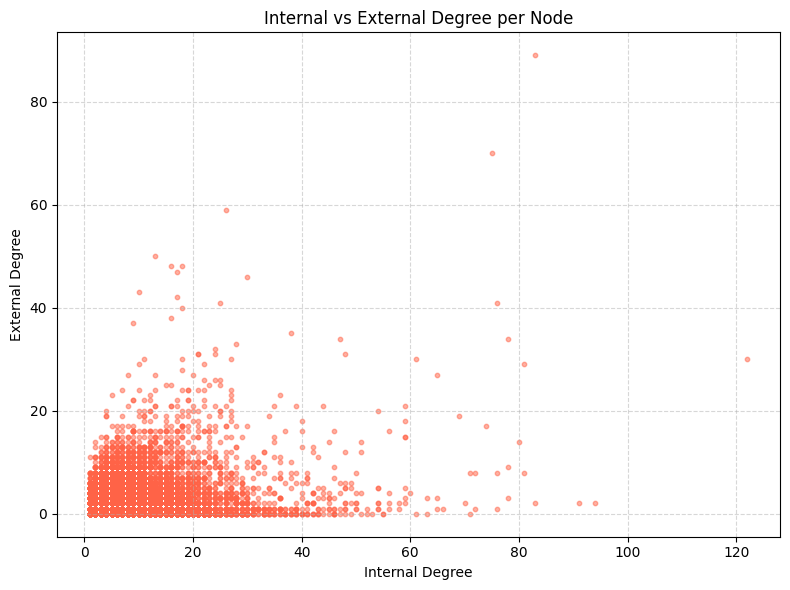

In [22]:
#create a map node -> community
membership = partition.membership
node2comm = {v.index: membership[i] for i, v in enumerate(G_ig.vs)}

internal_deg = []
external_deg = []

for v in G_ig.vs:
    comm = node2comm[v.index]
    deg = G_ig.degree(v.index)
    internal = 0
    for neighbor in G_ig.neighbors(v.index):
        if node2comm[neighbor] == comm:
            internal += 1
    external = deg - internal
    internal_deg.append(internal)
    external_deg.append(external)

plt.figure(figsize=(8,6))
plt.scatter(internal_deg, external_deg, alpha=0.5, s=10, color='tomato')
plt.xlabel("Internal Degree")
plt.ylabel("External Degree")
plt.title("Internal vs External Degree per Node")
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

Number of communities: 1984
Modularity of the partition: 0.4888
Min size: 2
Max size: 13494
Mean size: 14.25
Median size: 3.00
Std dev: 305.65


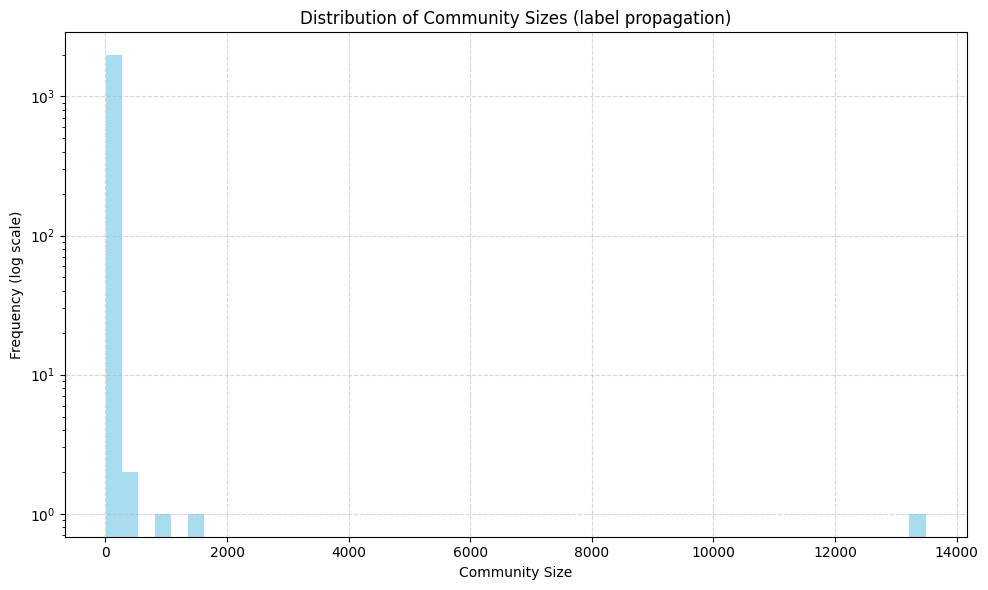

In [23]:
#run label propagation community detection
communities = list(nx.community.label_propagation_communities(G))
sizes = [len(c) for c in communities]
sizes_np = np.array(sizes)

#print basic statisics
print(f"Number of communities: {len(sizes)}")
print(f"Modularity of the partition: {nx.community.modularity(G, communities):.4f}")
print(f"Min size: {sizes_np.min()}")
print(f"Max size: {sizes_np.max()}")
print(f"Mean size: {sizes_np.mean():.2f}")
print(f"Median size: {np.median(sizes_np):.2f}")
print(f"Std dev: {sizes_np.std():.2f}")

#plot the data
plt.figure(figsize=(10,6))
plt.hist(sizes, bins=50, color="skyblue", alpha=0.7)
plt.yscale('log')
plt.xlabel("Community Size")
plt.ylabel("Frequency (log scale)")
plt.title("Distribution of Community Sizes (label propagation)")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

### Centralities

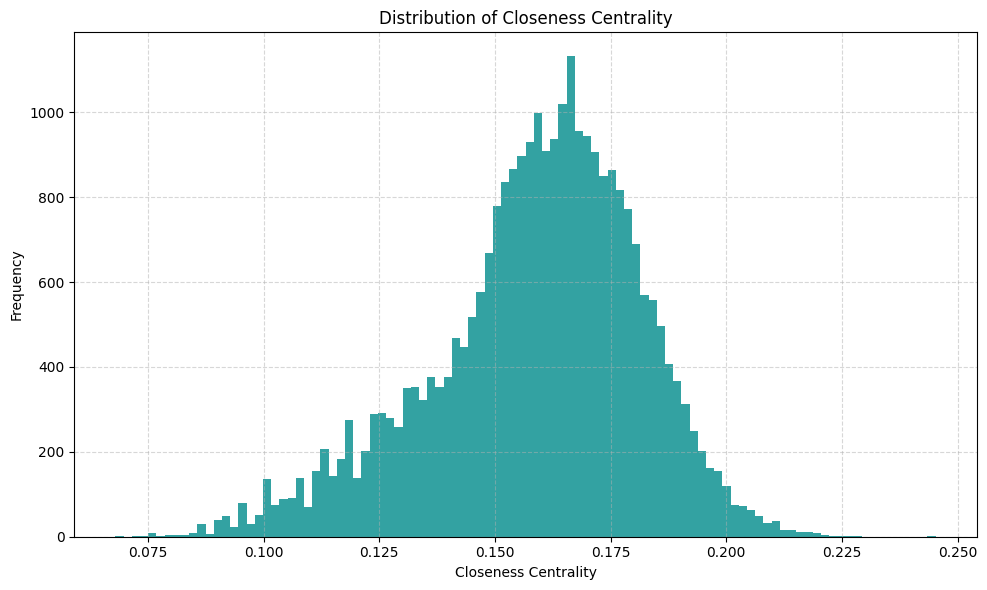

In [24]:
#!! potentially VERY long execution (~2m 30s on my laptop)

closeness = rx.closeness_centrality(G_rx)  #returns a dict: node -> closeness
closeness_values = list(closeness.values())

plt.figure(figsize=(10,6))
plt.hist(closeness_values, bins=100, color="darkcyan", alpha=0.8)
plt.xlabel("Closeness Centrality")
plt.ylabel("Frequency")
plt.title("Distribution of Closeness Centrality")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

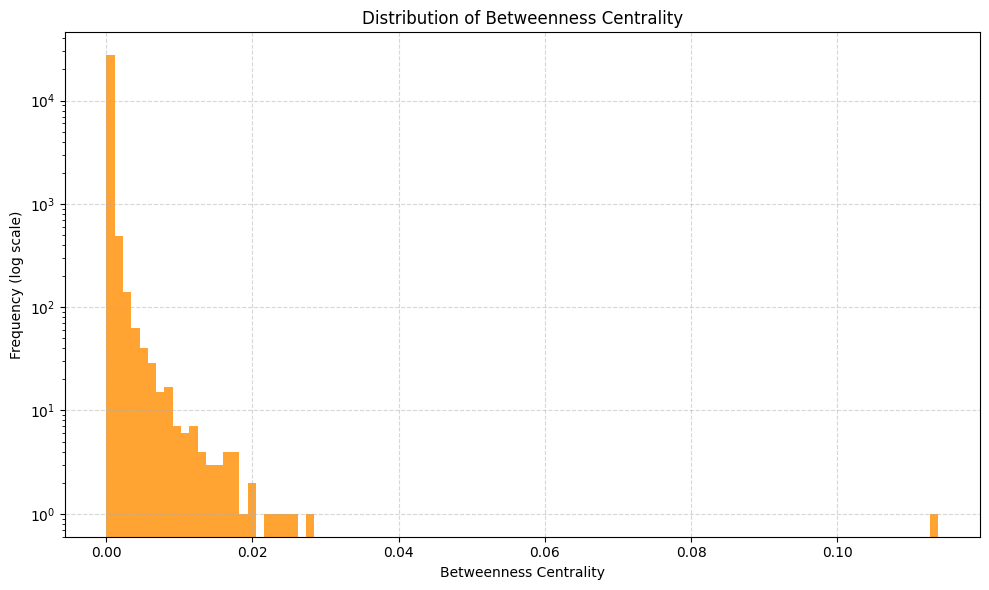

In [25]:
#!! possibly long execution time! (~1m 45s on my laptop)

#calculate the betweenness dictionary
bet_cent = rx.betweenness_centrality(G_rx)
bet_values = list(bet_cent.values())

#plot it
plt.figure(figsize=(10,6))
plt.hist(bet_values, bins=100, color="darkorange", alpha=0.8)
plt.xlabel("Betweenness Centrality")
plt.yscale('log')
plt.ylabel("Frequency (log scale)")
plt.title("Distribution of Betweenness Centrality")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

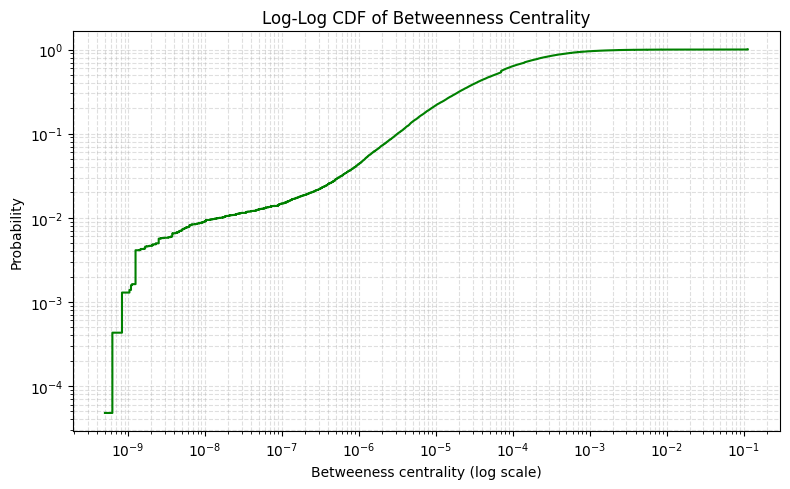

In [26]:
cents = [bet_cent[i] for i in range(len(G_rx.nodes()))]
#convert to numpy array and filter out zeros (log(0) is undefined)
bet_array = np.array(cents)
bet_array = bet_array[bet_array > 0]

#sort values and compute empirical CDF
sorted_vals = np.sort(bet_array)
cdf = np.arange(1, len(sorted_vals)+1) / len(sorted_vals)

#plot CDF in log-log scale
plt.figure(figsize=(8, 5))
plt.plot(sorted_vals, cdf, drawstyle='steps-post', color='green')
plt.xscale('log')
plt.yscale('log')
plt.xlabel("Betweeness centrality (log scale)")
plt.ylabel("Probability")
plt.title("Log-Log CDF of Betweenness Centrality")
plt.grid(True, which="both", linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()

In [27]:
#computing heterogeneity parameter
degrees = [deg for _, deg in G.degree()]
kappa = np.mean([k**2 for k in degrees]) / (np.mean(degrees))**2

print(f"Heterogeneity = {kappa:.4f}")

Heterogeneity = 2.4675


### Homophily

In [28]:
#load the CSV
gender_csv = pd.read_csv("deezer_europe_target.csv")
#create a dict {node_id: gender}
gender_dict = pd.Series(gender_csv["target"].values, index=gender_csv["id"]).to_dict()
#set attribute to nodes
nx.set_node_attributes(G, gender_dict, name="gender")

#computations for homophily
same = 0
diff = 0
#computing cross rations and cumulative counts
for u, v in G.edges():
    gu = G.nodes[u].get("gender")
    gv = G.nodes[v].get("gender")
    if gu == gv:
        same += 1
    else:
        diff += 1

total = same + diff
observed_cross_ratio = diff / total

#compute expected cross-gender edge fraction
genders = [G.nodes[n].get("gender") for n in G.nodes() if "gender" in G.nodes[n]]
freqs = cl.Counter(genders)
n_total = sum(freqs.values())
p = freqs[0] / n_total
q = freqs[1] / n_total
expected_cross_ratio = 2 * p * q

print(f"Observed cross-gender edge ratio: {observed_cross_ratio:.4f}")
print(f"Expected cross-gender ratio (random mixing): {expected_cross_ratio:.4f}")

if observed_cross_ratio < expected_cross_ratio:
    print("Evidence of homophily: fewer cross-gender edges than expected.")
else:
    print("No homophily detected: cross-group edges at or above random expectation.")

Observed cross-gender edge ratio: 0.4749
Expected cross-gender ratio (random mixing): 0.4936
Evidence of homophily: fewer cross-gender edges than expected.


## Comparison with random models


In [29]:
N = G.number_of_nodes()
L = G.number_of_edges()
avg_degree_real = 2 * L / N

#1)Erdős-Rényi (ER)
p_er = avg_degree_real / (N - 1)
G_er = nx.erdos_renyi_graph(N, p_er, seed=123)

#2)Watts-Strogatz (WS)
n_neigh = int(round(avg_degree_real))
if n_neigh % 2 != 0:  # must be even
    n_neigh += 1
p_shortcut = 0.5
G_ws = nx.watts_strogatz_graph(N, n_neigh, p_shortcut, seed=123)

#3)Configuration Model (degree-preserving)
degree_seq = [deg for _, deg in G.degree()]
G_conf = nx.configuration_model(degree_seq, seed=123)
G_conf = nx.Graph(G_conf)  #simplify graph (remove parallel edges)
G_conf.remove_edges_from(nx.selfloop_edges(G_conf))

#4)Barabási-Albert (BA)
m = max(1, int(round(avg_degree_real / 2)))
G_ba = nx.barabasi_albert_graph(N, m, seed=123)

In [30]:
def analyze_graph(G, name):
    
    N = G.number_of_nodes()
    L = G.number_of_edges()
    avg_deg = 2 * L / N
    clustering = nx.average_clustering(G)
    assortativity = nx.degree_assortativity_coefficient(G)

    #converto to rx for shortest path stuff
    if nx.is_connected(G):
        G_rx = rx.networkx_converter(G)
    else:
        Gcc = G.subgraph(max(nx.connected_components(G), key=len)).copy()
        G_rx = rx.networkx_converter(Gcc)

    avg_path_len = rx.unweighted_average_shortest_path_length(G_rx)

    print(f"--- {name} ---")
    print(f"Nodes: {N}")
    print(f"Edges: {L}")
    print(f"Average Degree: {avg_deg:.4f}")
    print(f"Average Clustering: {clustering:.4f}")
    print(f"Average Path Length: {avg_path_len:.4f}")
    print(f"Degree Assortativity: {assortativity:.4f}")
    print()

In [31]:
#!! long execution time! (~1m 45s on my laptop)

analyze_graph(G, "Real")
analyze_graph(G_er, "Erdős-Rényi")
analyze_graph(G_ws, "Watts-Strogatz")
analyze_graph(G_ba, "Barabási-Albert")
analyze_graph(G_conf, "Configuration")

--- Real ---
Nodes: 28281
Edges: 92752
Average Degree: 6.5593
Average Clustering: 0.1412
Average Path Length: 6.4498
Degree Assortativity: 0.1041

--- Erdős-Rényi ---
Nodes: 28281
Edges: 92558
Average Degree: 6.5456
Average Clustering: 0.0002
Average Path Length: 5.6749
Degree Assortativity: -0.0055

--- Watts-Strogatz ---
Nodes: 28281
Edges: 113124
Average Degree: 8.0000
Average Clustering: 0.0832
Average Path Length: 5.4862
Degree Assortativity: -0.0410

--- Barabási-Albert ---
Nodes: 28281
Edges: 84834
Average Degree: 5.9994
Average Clustering: 0.0022
Average Path Length: 4.6372
Degree Assortativity: -0.0245

--- Configuration ---
Nodes: 28281
Edges: 92678
Average Degree: 6.5541
Average Clustering: 0.0009
Average Path Length: 4.8591
Degree Assortativity: -0.0024



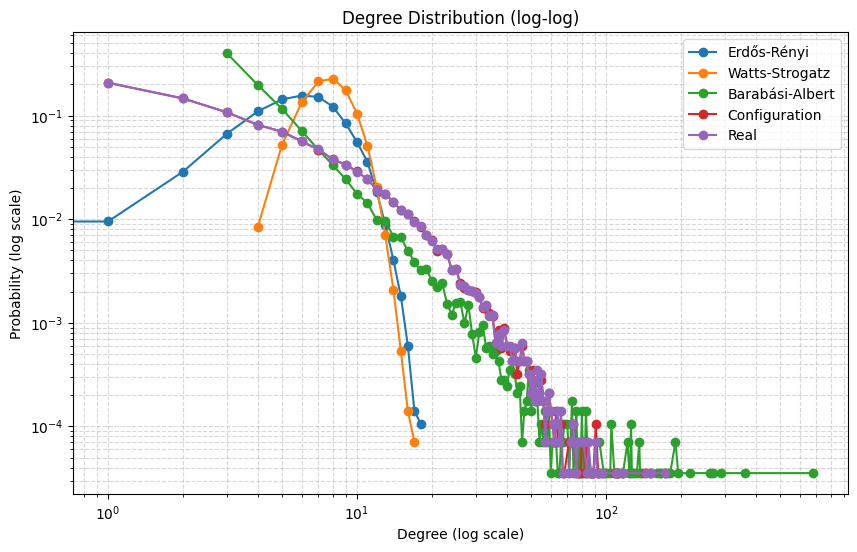

In [32]:
#plot degree distribution
def plot_degree_distribution(graphs, title="Degree Distribution (log-log)"):
    plt.figure(figsize=(10, 6))

    for name, G in graphs.items():
        degrees = [d for _, d in G.degree()]
        degree_counts = np.bincount(degrees)
        #trim zero values
        degrees_nonzero = np.nonzero(degree_counts)[0]
        counts_nonzero = degree_counts[degrees_nonzero]

        #normalize to probability
        prob = counts_nonzero / counts_nonzero.sum()

        plt.plot(degrees_nonzero, prob, marker='o', linestyle='-', label=name)

    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel("Degree (log scale)")
    plt.ylabel("Probability (log scale)")
    plt.title(title)
    plt.legend()
    plt.grid(True, which="both", ls="--", alpha=0.5)
    plt.show()

#create a dictionary of our graphs:
graphs = {
    "Erdős-Rényi": G_er,
    "Watts-Strogatz": G_ws,
    "Barabási-Albert": G_ba,
    "Configuration": G_conf,
    "Real": G
}

plot_degree_distribution(graphs)

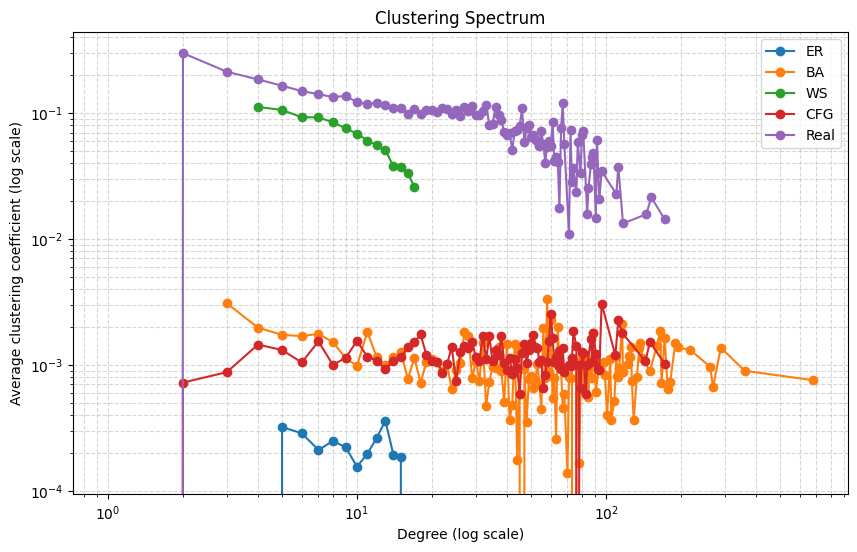

In [33]:
def plot_clustering_spectrum(G, label):
    degrees = dict(G.degree())
    clustering = nx.clustering(G)

    #group clustering values by degree
    degree_clust = {}
    for node, deg in degrees.items():
        degree_clust.setdefault(deg, []).append(clustering[node])

    #compute average clustering per degree
    degs = []
    avg_clusts = []
    for deg, clust_list in sorted(degree_clust.items()):
        degs.append(deg)
        avg_clusts.append(np.mean(clust_list))

    plt.plot(degs, avg_clusts, marker='o', linestyle='-', label=label)

#plot for real and models
plt.figure(figsize=(10,6))
plot_clustering_spectrum(G_er, "ER")
plot_clustering_spectrum(G_ba, "BA")
plot_clustering_spectrum(G_ws, "WS")
plot_clustering_spectrum(G_conf, "CFG")
plot_clustering_spectrum(G, "Real")
plt.xscale('log')
plt.yscale('log')
plt.xlabel("Degree (log scale)")
plt.ylabel("Average clustering coefficient (log scale)")
plt.title("Clustering Spectrum")
plt.legend()
plt.grid(True, which="both", linestyle="--", alpha=0.5)
plt.show()